<a href="https://colab.research.google.com/github/JorgeDuarte1509/Actividades_Aprendizaje-/blob/main/6_4_Extraccion_de_lineas_Equipo4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

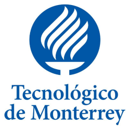

# Maestría en Inteligencia Artificial Aplicada
## TC 4033 Visión computacional para imágenes y video
### Tecnológico de Monterrey
### Prof Dr. Gilberto Ochoa Ruiz

## Equipo 04
Integrantes

> - Francisco Javier Parga García A01794380
> - Jorge Alberto Duarte Salinas  A01793015
> - Manuel Gerardo Licera Aguirre A00947315
> - Ricardo Morales Bustillos.    A01740032    
> - Jessica Paola Pulido Vásquez  A01793650

# Actividad 6.4
## Extracción de líneas con algoritmo de Canny


# TC 4033
## Visión computacional para imágenes y video
<br>

#### 6.4 Google Colab - Extracción de líneas con algoritmo de Canny
<br>

- Objetivo

    En esta actividad se implementará el método de extracción de líneas Canny usando OpenCV y Python desde los aspectos de bajo nivel y se harán modificaciones a los parámetros más importantes para comprender su impacto en el desempeño del algoritmo y poder concluir con hallazgos en cuanto a la comparación de los resultados.
  
- Instrucciones

    Para esta actividad se requiere:

1. Ingresar a Canvas y descargar el proyecto en Notebook Download Notebook.
2. Revisar los ejercicios propuestos antes de codificar e identificar las secciones de libro o de las slides que te puedan servir como soporte.
3. En este proyecto no pediremos extensiones o nuevas funciones. Sin embargo, se pide que se modifiquen algunos parámetros para que se comprenda mejor el codigo:  a) modifica el valor de sigma y observa los cambios en las lineas detectas, b) Analiza el comportamiento del Canny Detector con y sin remoción de ruido, c) Experimenta con imágenes con diferentes cantidad de lineas y textura para observar el comportamiento del algoritmo
4. Reporta brevemente tus hallazgos al final del Google Collab.

Los ejercicios que deben agregarse a este proyecto serán los siguientes:

a) Modifica el valor de sigma y observa los cambios en las lineas detectas.

b) Analiza el comportamiento del Canny Detector con y sin remoción de ruido.

c) Experimenta con imágenes con diferentes cantidad de lineas y textura para observar el comportamiento del algoritmo.

# 3. Sobel and Canny Edge Detection

## Table of Contents
1. [Libraries](#libraries)
2. [Sobel Edge Detection](#sobel)
3. [Canny Edge Detection](#canny)

## Importing Libraries <a class="anchor" id="libraries" ></a>

In [ ]:
import cv2
import skimage
import numpy as np
from scipy import ndimage
from skimage import exposure
from PIL import Image, ImageOps
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from scipy.ndimage.filters import convolve
from scipy.ndimage.filters import gaussian_filter as gauss
from scipy.ndimage.filters import median_filter as med

<ipython-input-1-884896f37a0d>:9: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import convolve
<ipython-input-1-884896f37a0d>:10: DeprecationWarning: Please use `gaussian_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import gaussian_filter as gauss
<ipython-input-1-884896f37a0d>:11: DeprecationWarning: Please use `median_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import median_filter as med


## Sobel Edge Detection <a class="anchor" id="sobel" ></a>

As a first step in extracting features, you will apply the Sobel edge detection algorithm. This finds regions of the image with large gradient values in multiple directions. Regions with high omnidirectional gradient are likely to be edges or transitions in the pixel values.

The code in the cell below applies the Sobel algorithm to the median filtered image, using these steps:

1. Convert the color image to grayscale for the gradient calculation since it is two dimensional.
2. Compute the gradient in the x and y (horizontal and vertical) directions.
3. Compute the magnitude of the gradient.
4. Normalize the gradient values.

In [ ]:
def edge_sobel(image):
    from scipy import ndimage
    import skimage.color as sc
    import numpy as np
    image = sc.rgb2gray(image) # Convert color image to gray scale
    dx = ndimage.sobel(image, 1)  # horizontal derivative
    dy = ndimage.sobel(image, 0)  # vertical derivative
    mag = np.hypot(dx, dy)  # magnitude
    mag *= 255.0 / np.amax(mag)  # normalize (Q&D)
    mag = mag.astype(np.uint8)
    return mag

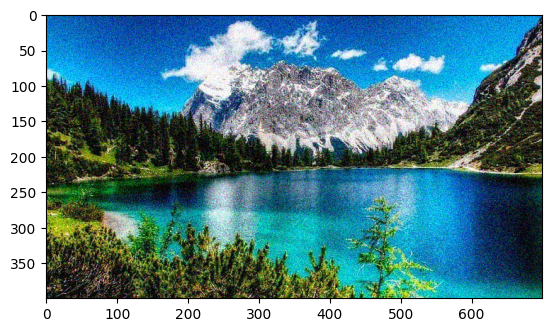

In [ ]:
original_image = np.load('/content/img.npy')

img = skimage.util.random_noise(original_image)
plt.imshow(img)

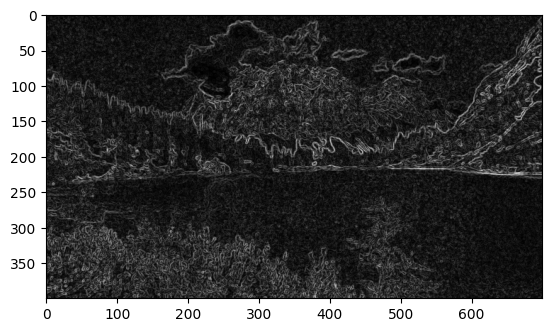

In [ ]:
img_med = med(img, size=2)
img_edge = edge_sobel(img_med)
plt.imshow(img_edge, cmap="gray")

Now let's try with the more blurred gaussian filtered image.


El sigma que se utiliza para este ejemplo es de Sigma=1.

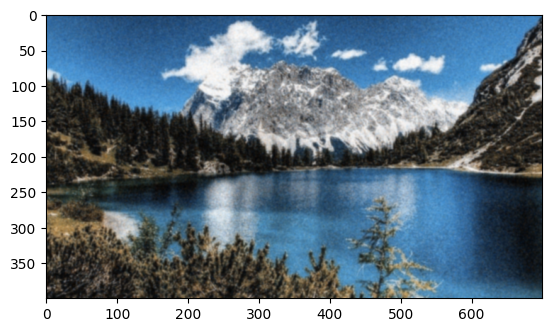

In [ ]:
img_gauss = gauss(img, sigma=1)
plt.imshow(img_gauss)

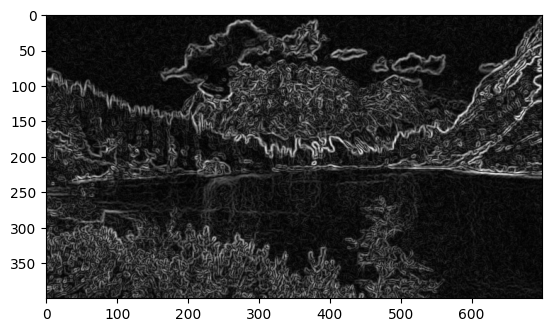

In [ ]:
img_edge = edge_sobel(img_gauss)
plt.imshow(img_edge, cmap="gray")

A continuación planteamos dos ajustes de sigma para posteriormente observar los cambios en las lineas detectadas.

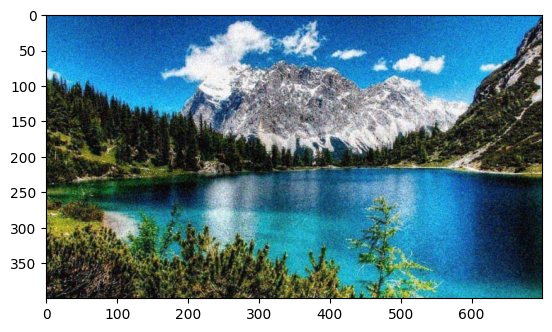

In [ ]:
img_gauss2 = gauss(img, sigma=0.5)
plt.imshow(img_gauss2)

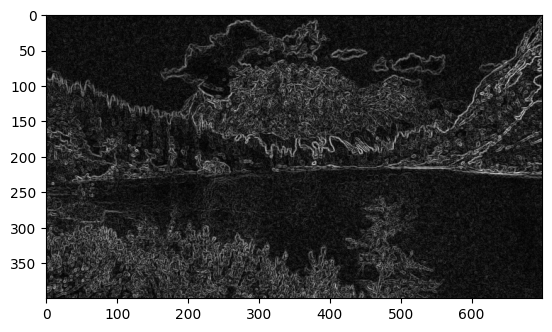

In [ ]:
img_edge2 = edge_sobel(img_gauss2)
plt.imshow(img_edge2, cmap="gray")

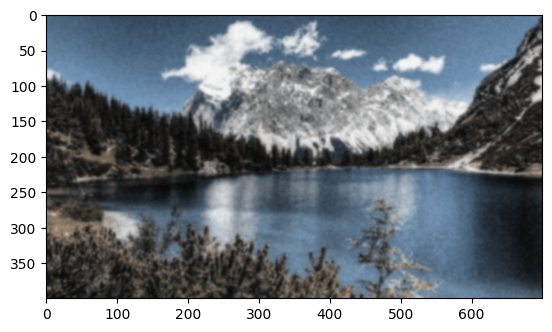

In [ ]:
img_gauss3 = gauss(img, sigma=1.5)
plt.imshow(img_gauss3)

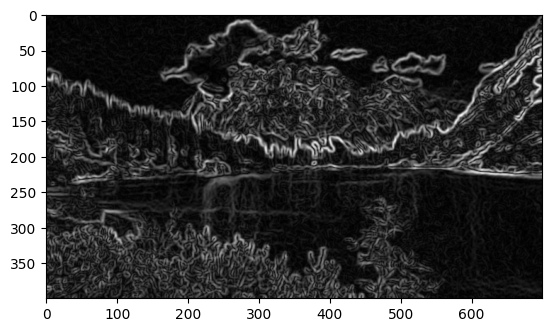

In [ ]:
img_edge3 = edge_sobel(img_gauss3)
plt.imshow(img_edge3, cmap="gray")

Imagen con valor de sigma= 0.5
Imagen con valor de sigma= 1
Imagen con valor de sigma= 1.5


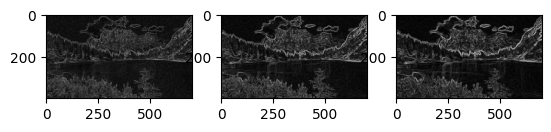

In [ ]:
plt.subplot(1, 3, 1)
print("Imagen con valor de sigma= 0.5")
plt.imshow(img_edge2, cmap="gray")

plt.subplot(1, 3, 2)
print("Imagen con valor de sigma= 1")
plt.imshow(img_edge, cmap="gray")

plt.subplot(1, 3, 3)
print("Imagen con valor de sigma= 1.5")
plt.imshow(img_edge3, cmap="gray")


Se  puede observar en la imagen que a mayor valor de sigma en la imagen se hace un mayor realce en las líneas de bordes detectadas.
Analizando cada una de las imágenes pudimos observar que con el sigma de 0.5 se logran detectar un mayor numero de líneas entre los objetos como las ramas de los pinos que se puede ver el detalle de esos bordes.

A diferencia de la imagen con un sigma de 1.5 donde el borde que hace difiere más entre un objeto a otro y descarta la información que esta dentro de cada objeto, dando así un mayor enfásis en cuanto a intensidad de los bordes entre pinos, montaña y lago.



## Canny Edge Detection <a class="anchor" id="canny" ></a>

Steps:
1. Noise Reduction
2. Gradient Calculation
3. Non-maximum Supression
4. Double Threshold
5. Edge Tracking by Hysteresis

**Pre-requisite:** Convert the image to grayscale before algorithm.

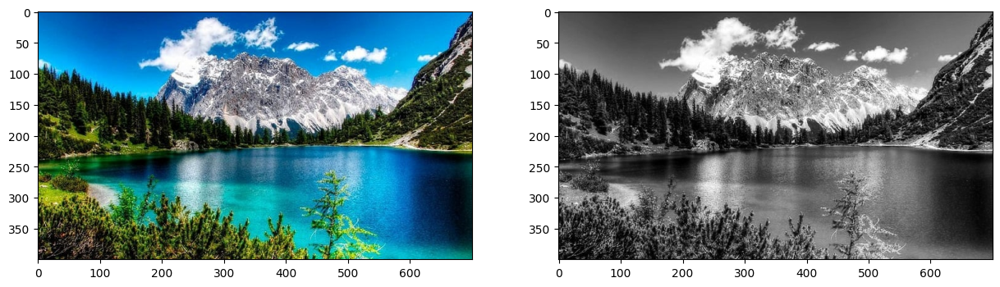

In [ ]:
img = cv2.imread('/content/image.jpg')

img_color = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_color)
plt.subplot(1, 2, 2)
plt.imshow(img_gray, cmap="gray")

### 1. Noise Reduction
Edge detection are highly sensitive to image noise due to the derivatives behind the algorithm.

We can apply a Gaussian Kernel, the size of the kernel depends on the expected blurring effect. The smaller the less blurring effect.

Equation for Gaussian Kernel of size $(2k+1) \times (2k+1)$

$$
H_{i, j} = \frac{1}{2\pi\sigma^2}exp(-\frac{(i-(k+1))^2 + (j-(k+1))^2}{2\sigma^2}); 1\leq i, j \leq (2k+1)
$$

In [ ]:
def gaussian_kernel(size, sigma=1):
    size = int(size) // 2
    x, y = np.mgrid[-size:size+1, -size:size+1]
    normal = 1 / (2.0 * np.pi * sigma**2)
    g =  np.exp(-((x**2 + y**2) / (2.0*sigma**2))) * normal
    return g

### 1.1 Sigma Parameter $\sigma$

In [ ]:
# Change this parameter
sigma = 10 # 1, 3, 5, 10, 20, ...

### 1.2 Kernel Size Parameter

In [ ]:
kernel_size = 3

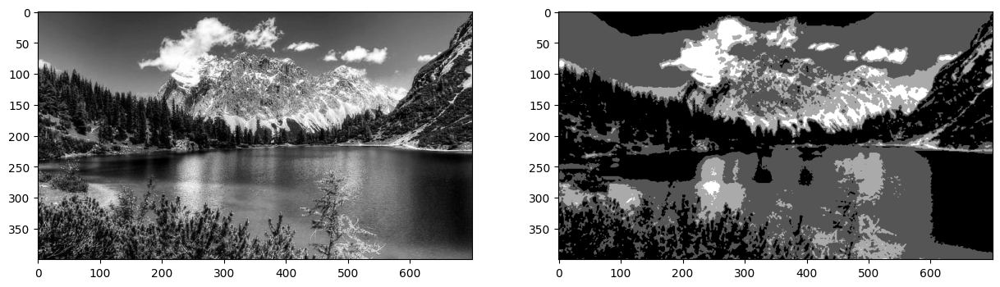

In [ ]:
img_gaussian = convolve(img_gray, gaussian_kernel(kernel_size, sigma))

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_gaussian, cmap="gray")

### 2. Gradient Calculation

Edges correspond to a change of pixels intensity.

To detect it, the easiest way is to apply filters that highlight this intensity change in both directions:
- horizontal $(x)$
- and vertical $(y)$

It can be implemented by convoling $I$ with *Sobel kernels* $Kx$ and $Ky$

$$
K_x = \begin{bmatrix}
-1 & 0 & 1\\
-2 & 0 & 2\\
-1 & 0 & 1
\end{bmatrix}, K_y = \begin{bmatrix}
1 & 2& 1\\
0 & 0 & 0\\
-1 & -2 & -1
\end{bmatrix}
$$

Then, the magnitude $G$ and the slope $\theta$ of the gradient are calculated as follow:

$$
|G| = \sqrt{I_x^2 + I_y^2},
\theta(x, y) = arctan(\frac{I_y}{I_x})
$$

In [ ]:
def sobel_filters(img):
    Kx = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], np.float32)
    Ky = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]], np.float32)

    Ix = ndimage.filters.convolve(img, Kx)
    Iy = ndimage.filters.convolve(img, Ky)

    G = np.hypot(Ix, Iy)
    G = G / G.max() * 255
    theta = np.arctan2(Iy, Ix)

    return (G, theta)

<ipython-input-36-58755cae58d6>:5: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  Ix = ndimage.filters.convolve(img, Kx)
<ipython-input-36-58755cae58d6>:6: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  Iy = ndimage.filters.convolve(img, Ky)


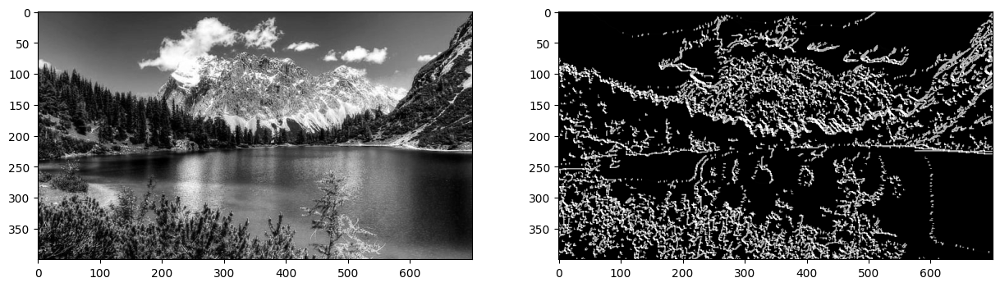

In [ ]:
G, theta = sobel_filters(img_gaussian)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(G, cmap="gray")

### 3. Non-Maximum supression

1. Create a matrix initialized to 0 of the same size of the original gradient intensity matrix
2. Identify the edge direction based on the angle value from the angle matrix
3. Check if the pixel in the same direction has a higher intensity than the pixel that is currently processed
4. Return the image processed with the non-max suppression algorithm.

In [ ]:
def non_max_suppression(img, D):
    M, N = img.shape
    Z = np.zeros((M,N), dtype=np.int32)
    angle = D * 180. / np.pi
    angle[angle < 0] += 180


    for i in range(1,M-1):
        for j in range(1,N-1):
            try:
                q = 255
                r = 255

               #angle 0
                if (0 <= angle[i,j] < 22.5) or (157.5 <= angle[i,j] <= 180):
                    q = img[i, j+1]
                    r = img[i, j-1]
                #angle 45
                elif (22.5 <= angle[i,j] < 67.5):
                    q = img[i+1, j-1]
                    r = img[i-1, j+1]
                #angle 90
                elif (67.5 <= angle[i,j] < 112.5):
                    q = img[i+1, j]
                    r = img[i-1, j]
                #angle 135
                elif (112.5 <= angle[i,j] < 157.5):
                    q = img[i-1, j-1]
                    r = img[i+1, j+1]

                if (img[i,j] >= q) and (img[i,j] >= r):
                    Z[i,j] = img[i,j]
                else:
                    Z[i,j] = 0

            except IndexError as e:
                pass

    return Z

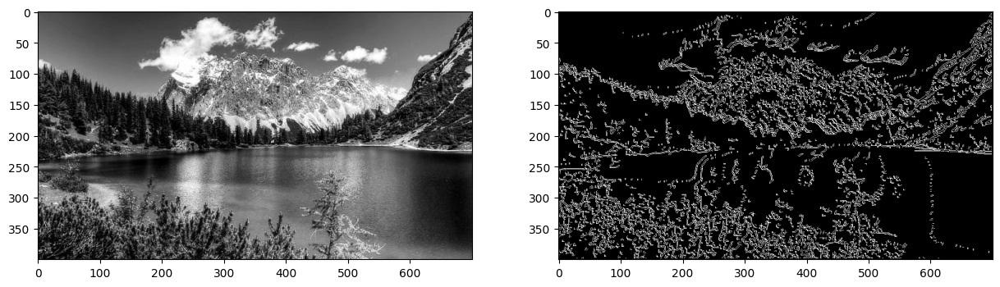

In [ ]:
img_nonmax = non_max_suppression(G, theta)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_nonmax, cmap="gray")

### 4. Double threshold

- Strong pixels are pixels that have an intensity so high that we are sure they contribute to the final edge.
- Weak pixels are pixels that have an intensity value that is not enough to be considered as strong ones, but yet not small enough to be considered as non-relevant for the edge detection.
- Other pixels are considered as non-relevant for the edge.

In [ ]:
def threshold(img, lowThresholdRatio=0.05, highThresholdRatio=0.09):

    highThreshold = img.max() * highThresholdRatio;
    lowThreshold = highThreshold * lowThresholdRatio;

    M, N = img.shape
    res = np.zeros((M,N), dtype=np.int32)

    weak = np.int32(25)
    strong = np.int32(255)

    strong_i, strong_j = np.where(img >= highThreshold)
    zeros_i, zeros_j = np.where(img < lowThreshold)

    weak_i, weak_j = np.where((img <= highThreshold) & (img >= lowThreshold))

    res[strong_i, strong_j] = strong
    res[weak_i, weak_j] = weak

    return (res)

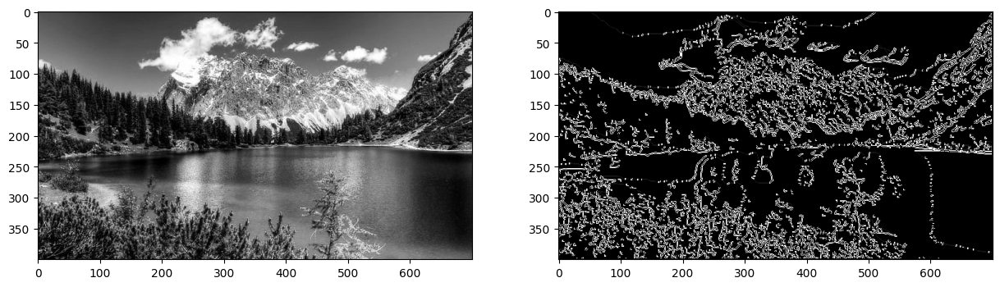

In [ ]:
img_threshold = threshold(img_nonmax)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_threshold, cmap="gray")

### 5. Edge Tracking by Hysteresis

The hysteresis consists of transforming weak pixels into strong ones, if and only if at least one of the pixels around the one being processed is a strong one

In [ ]:
def hysteresis(img, weak = 75, strong=255):
    M, N = img.shape
    for i in range(1, M-1):
        for j in range(1, N-1):
            if (img[i,j] == weak):
                try:
                    if ((img[i+1, j-1] == strong) or (img[i+1, j] == strong) or (img[i+1, j+1] == strong)
                        or (img[i, j-1] == strong) or (img[i, j+1] == strong)
                        or (img[i-1, j-1] == strong) or (img[i-1, j] == strong) or (img[i-1, j+1] == strong)):
                        img[i, j] = strong
                    else:
                        img[i, j] = 0
                except IndexError as e:
                    pass
    return img

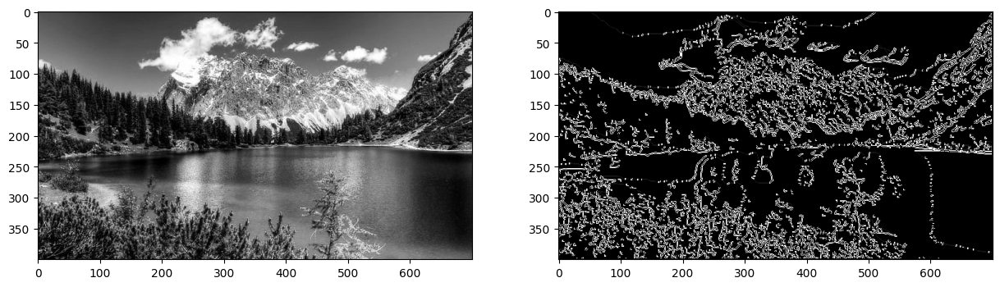

In [ ]:
img_final = hysteresis(img_threshold)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_final, cmap="gray")

## A continuación procedemos a realizar los ejercicios propuestos para esta actividad:

### a) Modifica el valor de sigma y observa los cambios en las lineas detectas.

### b) Analiza el comportamiento del Canny Detector con y sin remoción de ruido.

### c) Experimenta con imágenes con diferentes cantidad de lineas y textura para observar el comportamiento del algoritmo.

## a) Modifica el valor de sigma y observa los cambios en las lineas detectas.

# Sigma = 1

In [ ]:
#Se define Valor de 1 en sigma para proceder con el análisis.
sigma = 1 # Valor de Sigma
kernel_size = 3

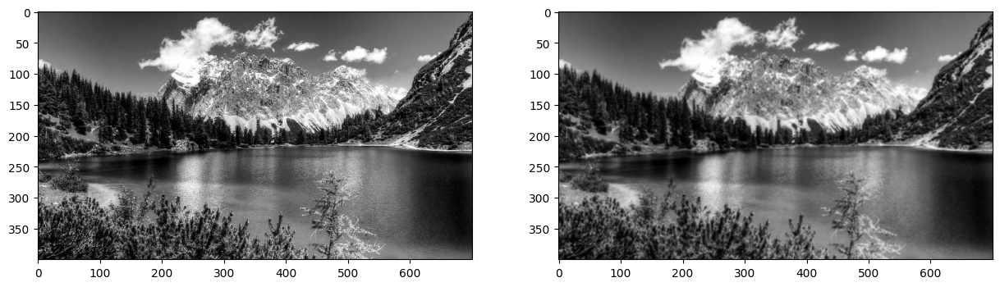

In [ ]:
# Kernel Size parameter
img_gaussian2 = convolve(img_gray, gaussian_kernel(kernel_size, sigma))

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_gaussian2, cmap="gray")

<ipython-input-36-58755cae58d6>:5: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  Ix = ndimage.filters.convolve(img, Kx)
<ipython-input-36-58755cae58d6>:6: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  Iy = ndimage.filters.convolve(img, Ky)


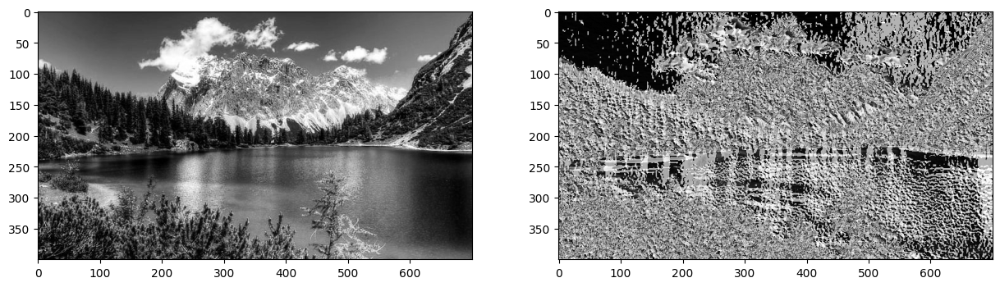

In [ ]:
#Gradient Calculation
G, theta = sobel_filters(img_gaussian2)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(G, cmap="gray")

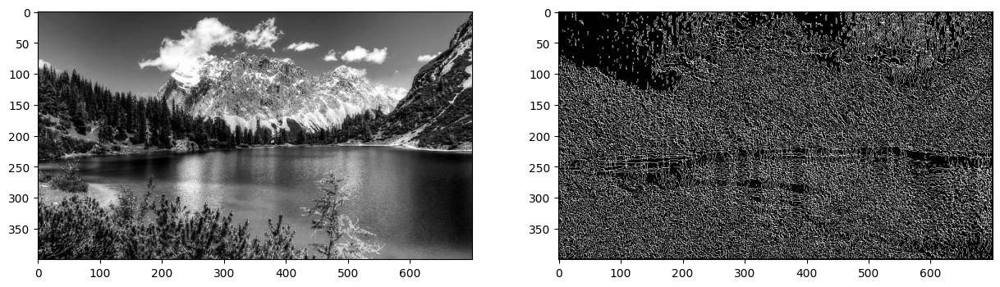

In [ ]:
#Non Maximum Supression
img_nonmax2 = non_max_suppression(G, theta)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_nonmax2, cmap="gray")

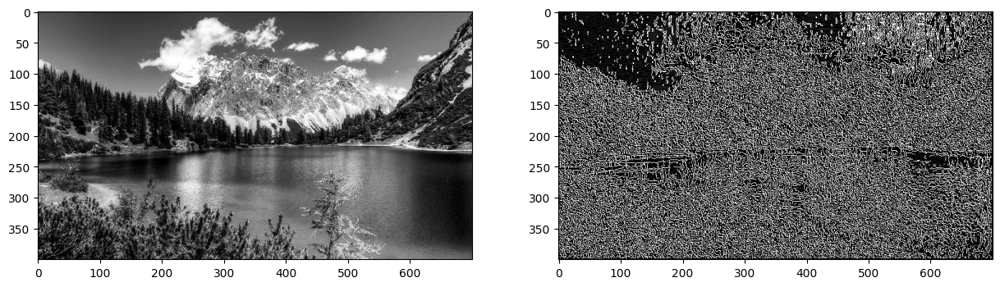

In [ ]:
#Double Threshold
img_threshold2 = threshold(img_nonmax2)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_threshold2, cmap="gray")

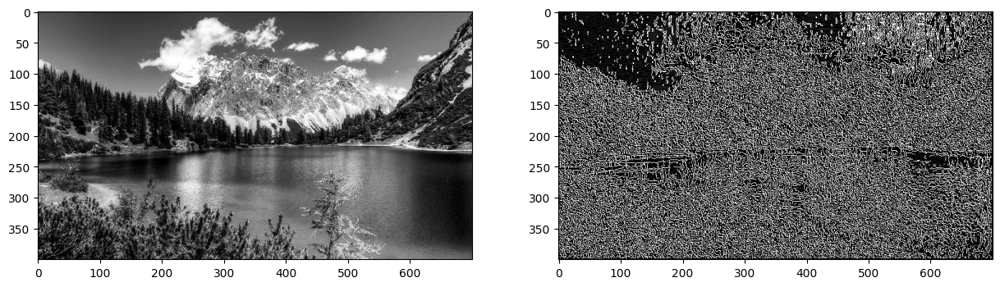

In [ ]:
#Edge Tracking by Hysteresis

img_final2 = hysteresis(img_threshold2)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_final2, cmap="gray")

# Sigma= 5

In [ ]:
#Se define Valor de 5 en sigma para proceder con el análisis.
sigma = 5 # Valor de Sigma
kernel_size = 3

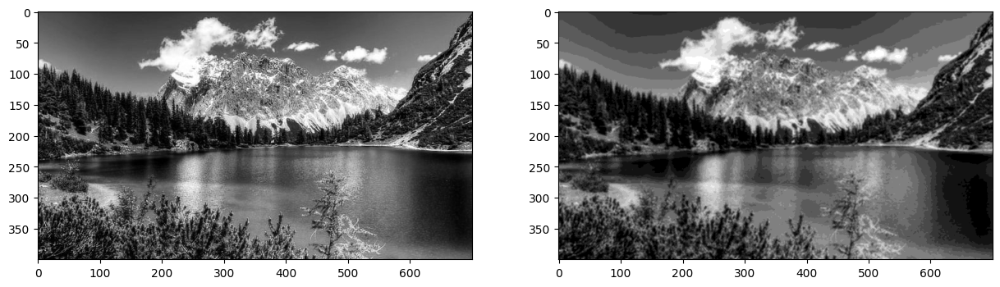

In [ ]:
# Kernel Size parameter
img_gaussian3 = convolve(img_gray, gaussian_kernel(kernel_size, sigma))

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_gaussian3, cmap="gray")

<ipython-input-36-58755cae58d6>:5: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  Ix = ndimage.filters.convolve(img, Kx)
<ipython-input-36-58755cae58d6>:6: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  Iy = ndimage.filters.convolve(img, Ky)


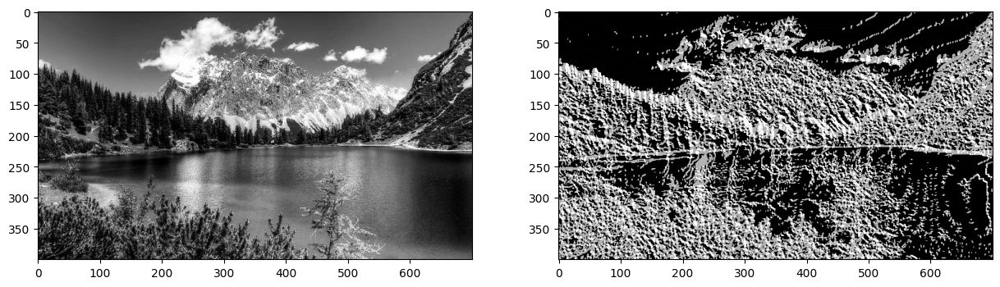

In [ ]:
#Gradient Calculation
G, theta = sobel_filters(img_gaussian3)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(G, cmap="gray")

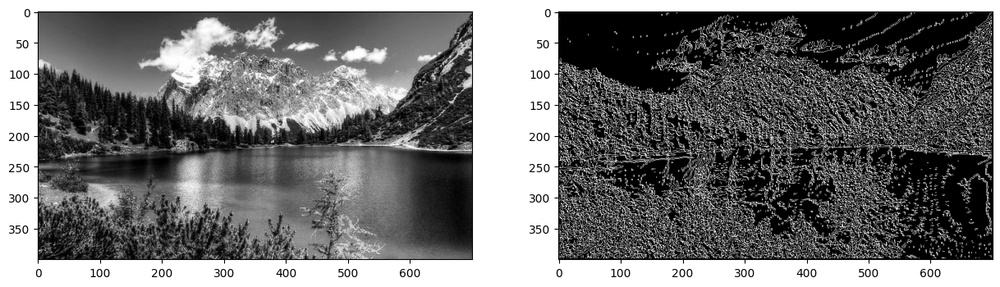

In [ ]:
#Non Maximum Supression
img_nonmax3 = non_max_suppression(G, theta)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_nonmax3, cmap="gray")

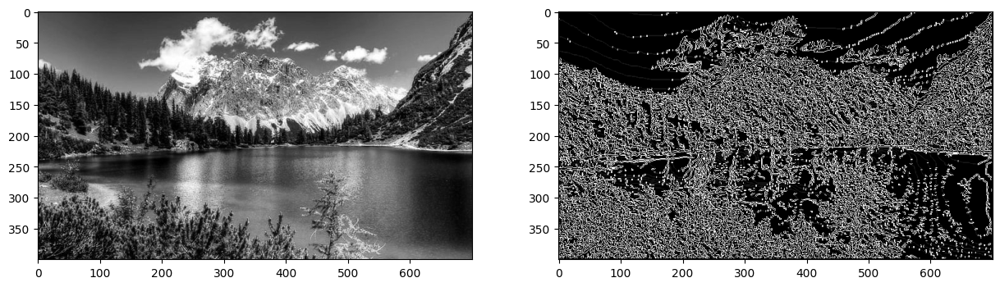

In [ ]:
#Double Threshold
img_threshold3 = threshold(img_nonmax3)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_threshold3, cmap="gray")

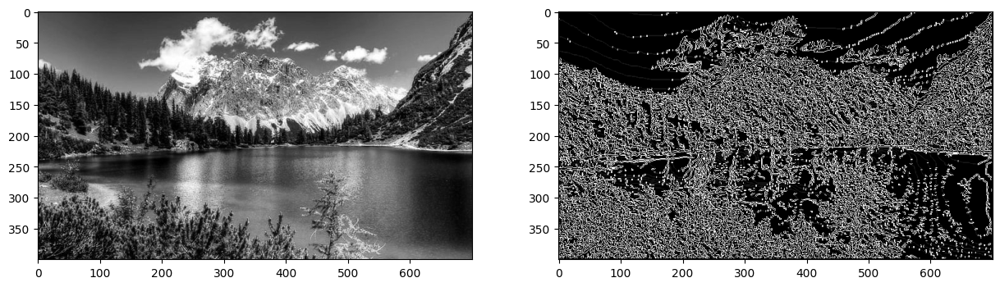

In [ ]:
#Edge Tracking by Hysteresis

img_final3 = hysteresis(img_threshold3)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_final3, cmap="gray")

# Sigma= 15


In [ ]:
#Se define Valor de 15 en sigma para proceder con el análisis.
sigma = 15 # Valor de Sigma
kernel_size = 3

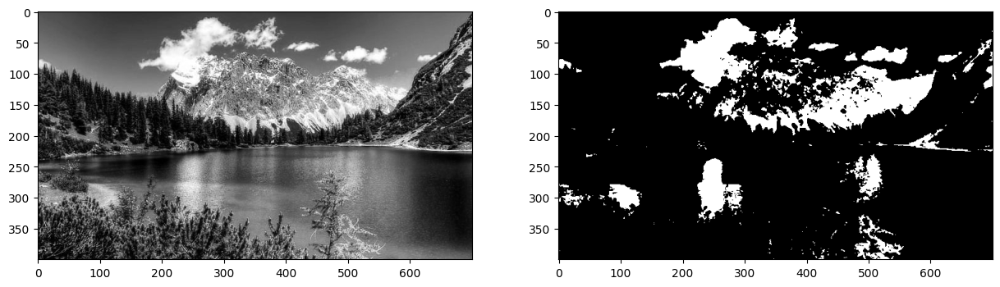

In [ ]:
# Kernel Size parameter
img_gaussian4 = convolve(img_gray, gaussian_kernel(kernel_size, sigma))

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_gaussian4, cmap="gray")

<ipython-input-36-58755cae58d6>:5: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  Ix = ndimage.filters.convolve(img, Kx)
<ipython-input-36-58755cae58d6>:6: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  Iy = ndimage.filters.convolve(img, Ky)


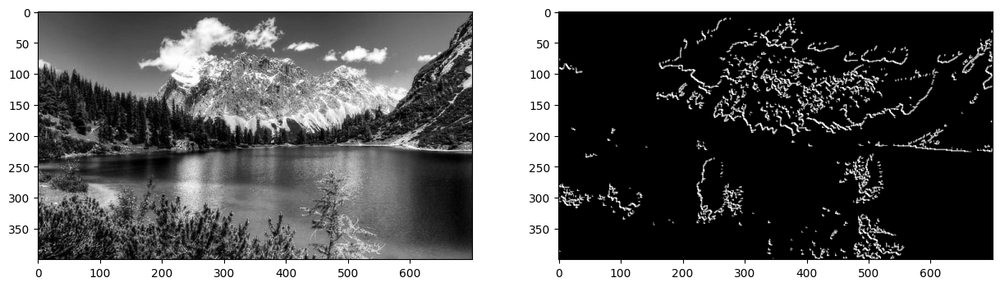

In [ ]:
#Gradient Calculation
G, theta = sobel_filters(img_gaussian4)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(G, cmap="gray")

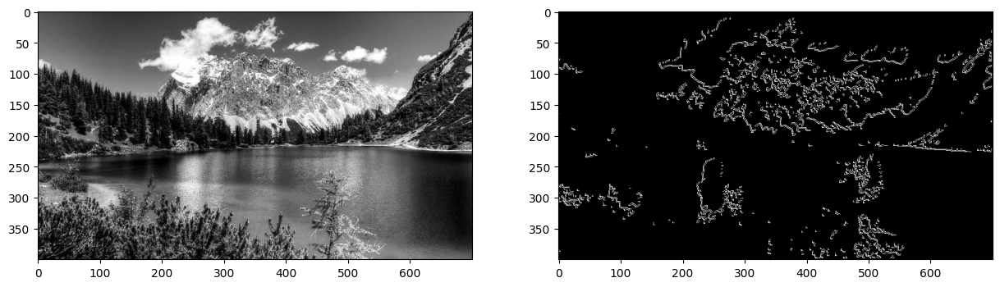

In [ ]:
#Non Maximum Supression
img_nonmax4 = non_max_suppression(G, theta)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_nonmax4, cmap="gray")

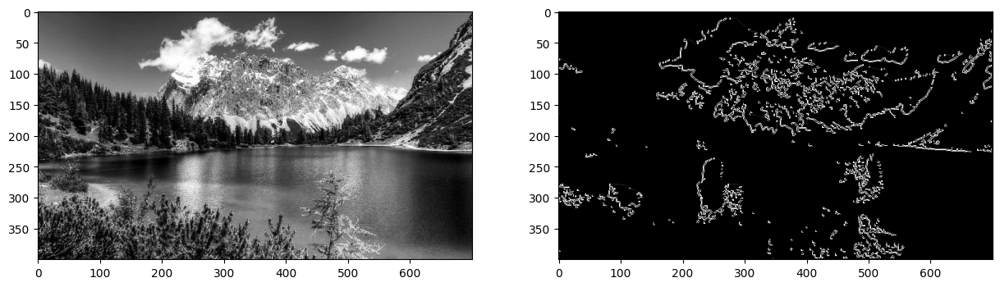

In [ ]:
#Double Threshold
img_threshold4 = threshold(img_nonmax4)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_threshold4, cmap="gray")

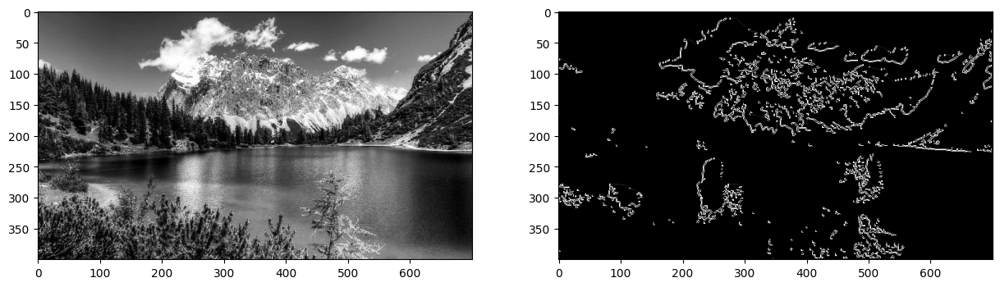

In [ ]:
#Edge Tracking by Hysteresis

img_final4 = hysteresis(img_threshold4)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_final4, cmap="gray")

# b) Analiza el comportamiento del Canny Detector sin remoción de ruido


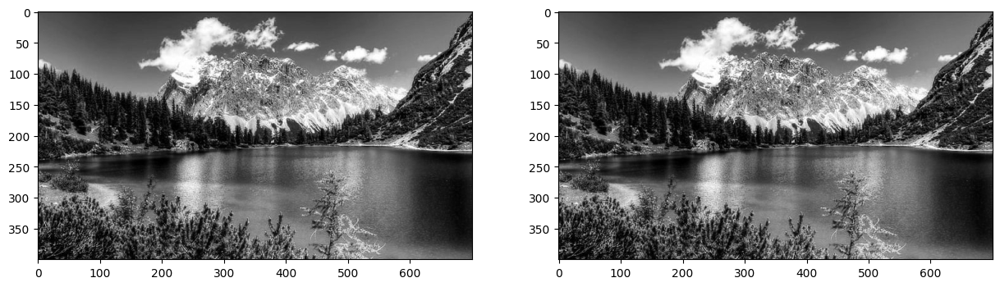

In [ ]:
# Kernel Size parameter
img_gaussian5 = img_gray

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_gaussian5, cmap="gray")

<ipython-input-36-58755cae58d6>:5: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  Ix = ndimage.filters.convolve(img, Kx)
<ipython-input-36-58755cae58d6>:6: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  Iy = ndimage.filters.convolve(img, Ky)


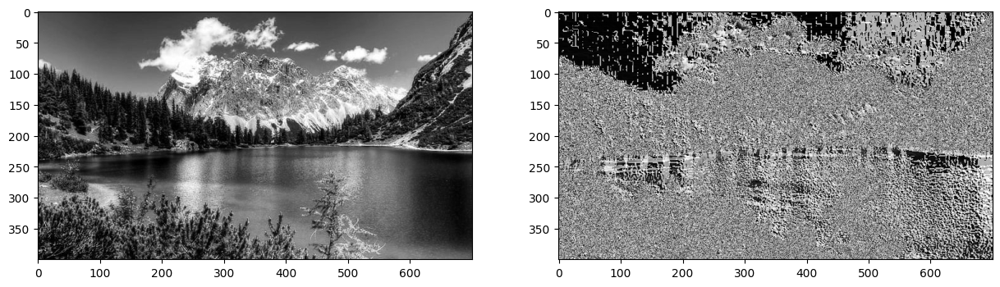

In [ ]:
#Gradient Calculation
G, theta = sobel_filters(img_gaussian5)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(G, cmap="gray")

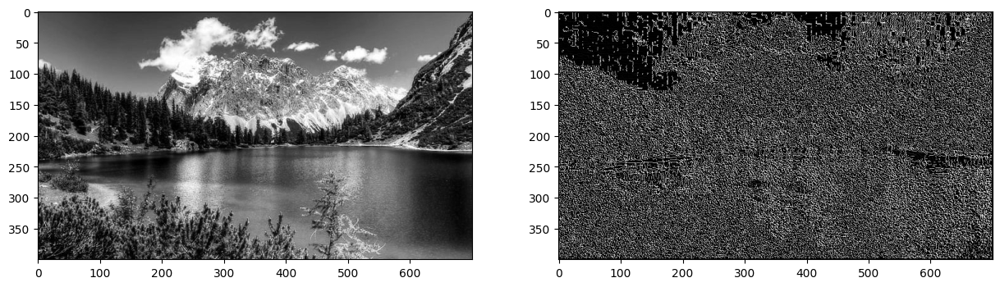

In [ ]:
#Non Maximum Supression
img_nonmax5 = non_max_suppression(G, theta)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_nonmax5, cmap="gray")

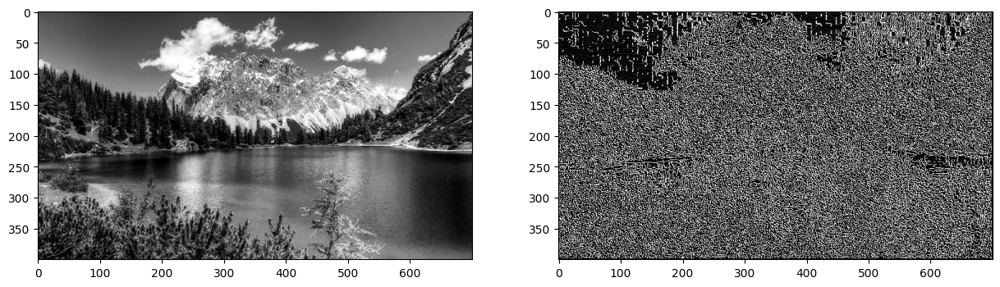

In [ ]:
#Double Threshold
img_threshold5 = threshold(img_nonmax5)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_threshold5, cmap="gray")

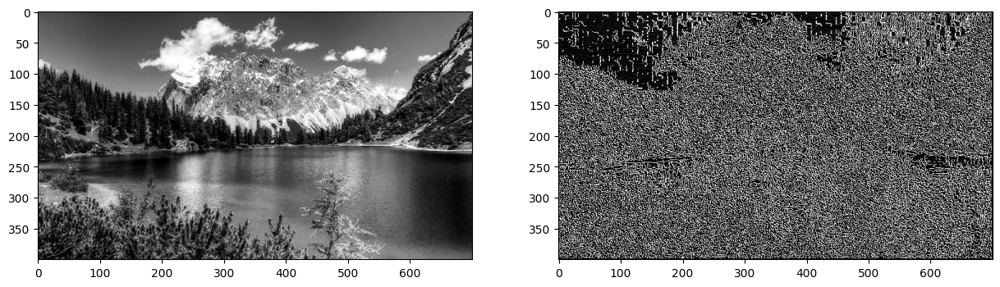

In [ ]:
#Edge Tracking by Hysteresis

img_final5 = hysteresis(img_threshold5)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_final5, cmap="gray")

# c) Experimenta con imágenes con diferentes cantidad de lineas y textura para observar el comportamiento del algoritmo

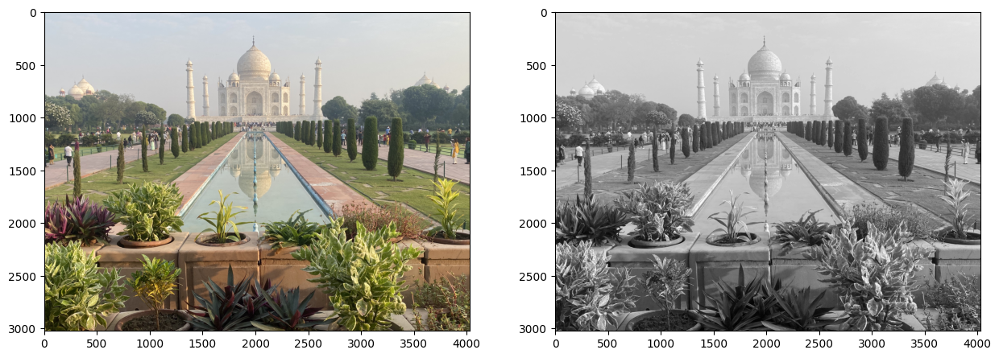

In [ ]:
img = cv2.imread('/content/India.jpeg')

img_color = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_color)
plt.subplot(1, 2, 2)
plt.imshow(img_gray, cmap="gray")

In [ ]:
#Se define Valor de 10 en sigma para proceder con el análisis.
sigma = 10 # Valor de Sigma
kernel_size = 3

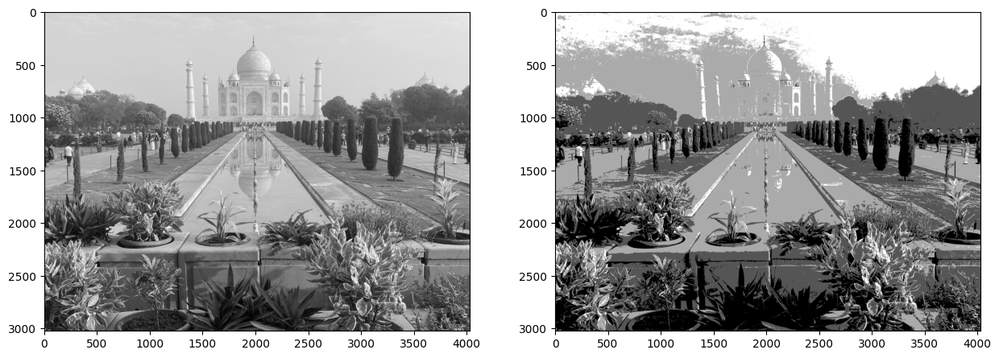

In [ ]:
# Kernel Size parameter
img_gaussian6 = convolve(img_gray, gaussian_kernel(kernel_size, sigma))

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_gaussian6, cmap="gray")

<ipython-input-36-58755cae58d6>:5: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  Ix = ndimage.filters.convolve(img, Kx)
<ipython-input-36-58755cae58d6>:6: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  Iy = ndimage.filters.convolve(img, Ky)


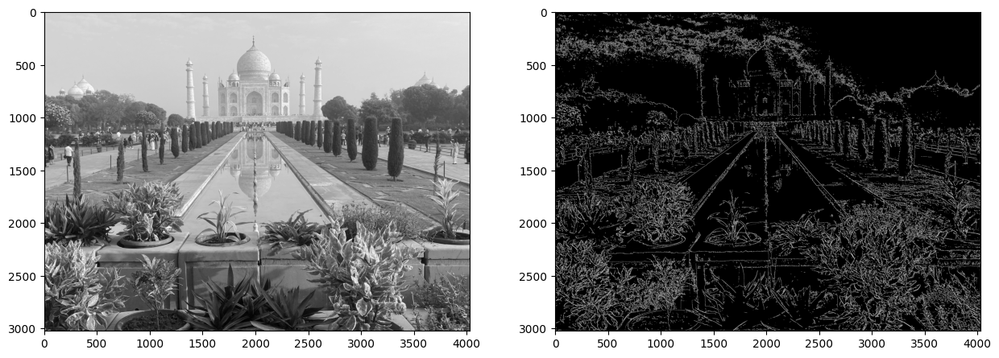

In [ ]:
#Gradient Calculation
G, theta = sobel_filters(img_gaussian6)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(G, cmap="gray")

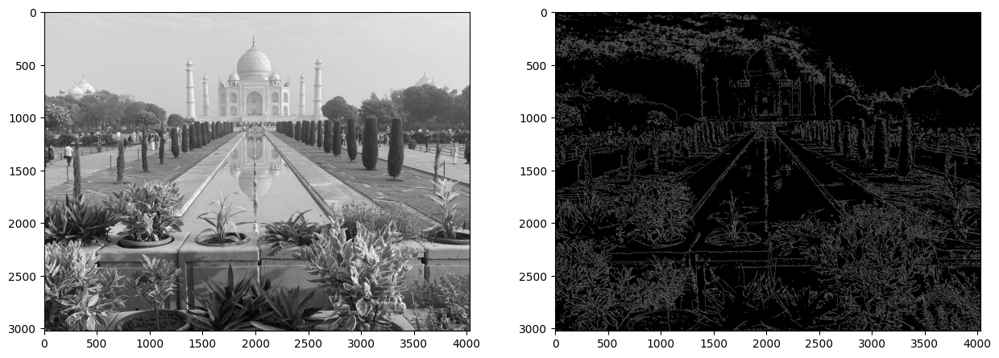

In [ ]:
#Non Maximum Supression
img_nonmax6 = non_max_suppression(G, theta)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_nonmax6, cmap="gray")

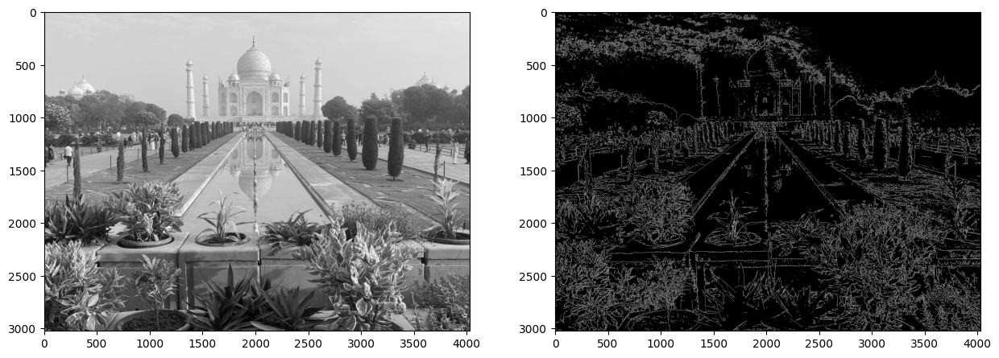

In [ ]:
#Double Threshold
img_threshold6 = threshold(img_nonmax6)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_threshold6, cmap="gray")

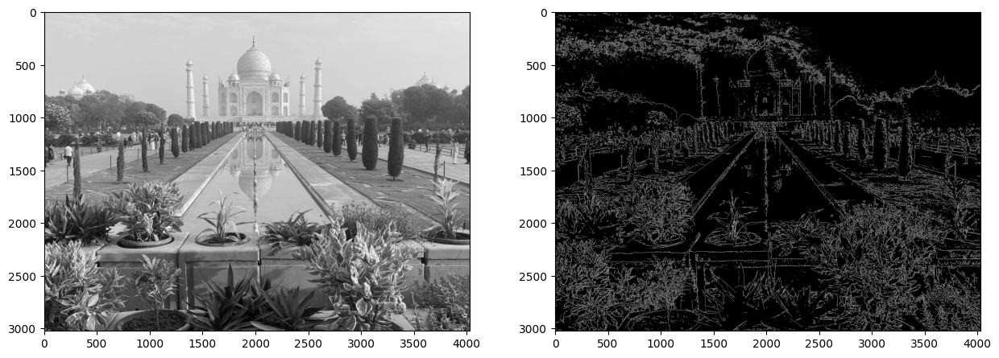

In [ ]:
#Edge Tracking by Hysteresis

img_final6 = hysteresis(img_threshold6)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_final6, cmap="gray")

# 4. Reporta brevemente tus hallazgos al final del Google Collab.



Al hacer el ejerecicio modificando el valor de sigma, en el cual hicimos pruebas con valores de 1, 5, 10 y 15, pudimos observar que un sigma muy bajo puede generar muchas líneas de borde que  no es posible hacer un análisis por que no se logra apreciar donde terminan los bordes, al aumentar el valor de sigma observamos que la situación mejoró, más el sigma de 15 lo que hace es que desaparecen muchos de los bordes por lo que concluimos que se debe tener cuidado al seleccionar el sigma y seleccionar uno que nos de valor al hacer el análisis sin llegar a perder la información valiosa del estudio.

El comportamiento del Canny Detector sin remoción de ruido lo hace imposible de analizar ya que de tanto ruido no se logra hacer una buena distinción de los objetos de la imagen, por lo que este paso es importante al utilizar el Canny detector.

Por último se utilizó el Canny Detector con otra imágen para visualizar como se comportaba con una imágen con diferente cantidad de líneas y textura, en este caso mantuvimos el sigma de 10 del cual se vió un buen resultado con el ejercicio que hicimos y siguió manteniendo un buen resultado al poder visualizar los bordes de los objetos, aunque el domo perdiera un poco el borde.

In [ ]:
print('Fecha 18 de Febrero del 2024')

Fecha 18 de Febrero del 2024
